<a href="https://colab.research.google.com/github/arnavtope11/Wildfire-Detection/blob/main/Wildfire_Detection_using_Scaled_Yolov4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# clone Scaled_YOLOv4
!git clone https://github.com/WongKinYiu/ScaledYOLOv4.git  # clone repo
%cd /content/ScaledYOLOv4/
#checkout the yolov4-large branch
!git checkout yolov4-large

Cloning into 'ScaledYOLOv4'...
remote: Enumerating objects: 233, done.
remote: Counting objects: 100% (99/99), done.
remote: Compressing objects: 100% (99/99), done.
remote: Total 233 (delta 48), reused 10 (delta 0), pack-reused 134
Receiving objects: 100% (233/233), 446.89 KiB | 5.96 MiB/s, done.
Resolving deltas: 100% (107/107), done.
/content/ScaledYOLOv4
Already on 'yolov4-large'
Your branch is up to date with 'origin/yolov4-large'.


In [ ]:
import torch
print('Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)


In [ ]:
#installing mish activation funciton for cuda
%cd /content/
!git clone https://github.com/JunnYu/mish-cuda
%cd mish-cuda
!python setup.py build install

/content
Cloning into 'mish-cuda'...
remote: Enumerating objects: 195, done.
remote: Counting objects: 100% (88/88), done.
remote: Compressing objects: 100% (75/75), done.
remote: Total 195 (delta 7), reused 79 (delta 3), pack-reused 107
Receiving objects: 100% (195/195), 208.77 KiB | 1.11 MiB/s, done.
Resolving deltas: 100% (56/56), done.
/content/mish-cuda
/usr/lib/python3.7/distutils/extension.py:131: UserWarning: Unknown Extension options: 'headers'
  warnings.warn(msg)
running build
running build_py
creating build
creating build/lib.linux-x86_64-3.7
creating build/lib.linux-x86_64-3.7/mish_cuda
copying src/mish_cuda/__init__.py -> build/lib.linux-x86_64-3.7/mish_cuda
running egg_info
creating src/mish_cuda.egg-info
writing src/mish_cuda.egg-info/PKG-INFO
writing dependency_links to src/mish_cuda.egg-info/dependency_links.txt
writing requirements to src/mish_cuda.egg-info/requires.txt
writing top-level names to src/mish_cuda.egg-info/top_level.txt
writing manifest file 'src/mish_cu

In [ ]:
!pip install -U PyYAML

     |████████████████████████████████| 645kB 8.5MB/s 
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
%cd /content/ScaledYOLOv4/


/content/ScaledYOLOv4


In [ ]:
# Exported code snippet for dataset
%cd /content
!curl -L "https://app.roboflow.com/ds/0uX0xQgWBT?key=gW5isqDDKn" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   895  100   895    0     0   1651      0 --:--:-- --:--:-- --:--:--  1651
100 73.1M  100 73.1M    0     0  45.1M      0  0:00:01  0:00:01 --:--:-- 83.7M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/ck0k9ghqt7a8l0944mcvy0jsx_jpeg.rf.67e2a90371e4338bd4f02e3d788e5399.jpg  
 extracting: test/images/ck0kcju199xgd0721ljl6cd2n_jpeg.rf.20be4ec6529ae16ff082da6d800580c9.jpg  
 extracting: test/images/ck0kcko719xjn0721pujcl4if_jpeg.rf.0358b337ab700afd5371bf4b6aecb909.jpg  
 extracting: test/images/ck0kd70pu4w7b07946742zfpg_jpeg.rf.fd8cfe9bbc0890c948142898867447e8.jpg  
 extracting: test/images/ck0keq7xa4xxd0863otmigtsy_jpeg.rf.ada9232f09752292dddd64d1d62907f7.jpg  
 extracting: test/images/ck0kfnjva6jp6083

In [ ]:
# this is the YAML file
%cat /content/data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['smoke']

In [ ]:
#Scaled-YOLOv4 Configuration architecture
%cat /content/ScaledYOLOv4/models/yolov4-p5.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 1.0  # model depth multiple
width_multiple: 1.0  # layer channel multiple

# anchors
anchors:
  - [13,17,  31,25,  24,51, 61,45]  # P3/8
  - [48,102,  119,96, 97,189, 217,184]  # P4/16
  - [171,384, 324,451, 616,618, 800,800]  # P5/32

# csp-p5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [32, 3, 1]],  # 0
   [-1, 1, Conv, [64, 3, 2]],  # 1-P1/2
   [-1, 1, BottleneckCSP, [64]],
   [-1, 1, Conv, [128, 3, 2]],  # 3-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 5-P3/8
   [-1, 15, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 7-P4/16
   [-1, 15, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]], # 9-P5/32
   [-1, 7, BottleneckCSP, [1024]],  # 10
  ]

# yolov4-p5 head
# na = len(anchors[0])
head:
  [[-1, 1, SPPCSP, [512]], # 11
   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [8, 1, Conv, [256, 1, 1]], # route backbone P4
   [[-1, -2], 1,

In [ ]:
!nvidia-smi

Fri Jun 11 17:27:58 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.27       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P0    27W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# training scaled-YOLOv4
# timing its performance
%%time
import gc
%cd /content/ScaledYOLOv4/
!python train.py --img 416 --batch 16 --epochs 300 --data '../data.yaml' --cfg ./models/yolov4-p5.yaml --weights '' --name yolov4-p5-results  --cache
#!gc.collect()
#!torch.cuda.empty_cache()

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/yolov4-p5.yaml', data='../data.yaml', device='', epochs=300, evolve=False, global_rank=-1, hyp='data/hyp.scratch.yaml', img_size=[416, 416], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-p5-results', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-06-10 21:31:07.717156: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.015

In [ ]:
# logs save in the folder "runs"
%reload_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
#from utils.general import plot_results  # plot results.txt as results.png
from IPython.display import Image, display
display(Image('/content/ScaledYOLOv4/runs/exp0_yolov4-csp-results/results.png'))  # view results.png

GROUND TRUTH TESTING DATA:


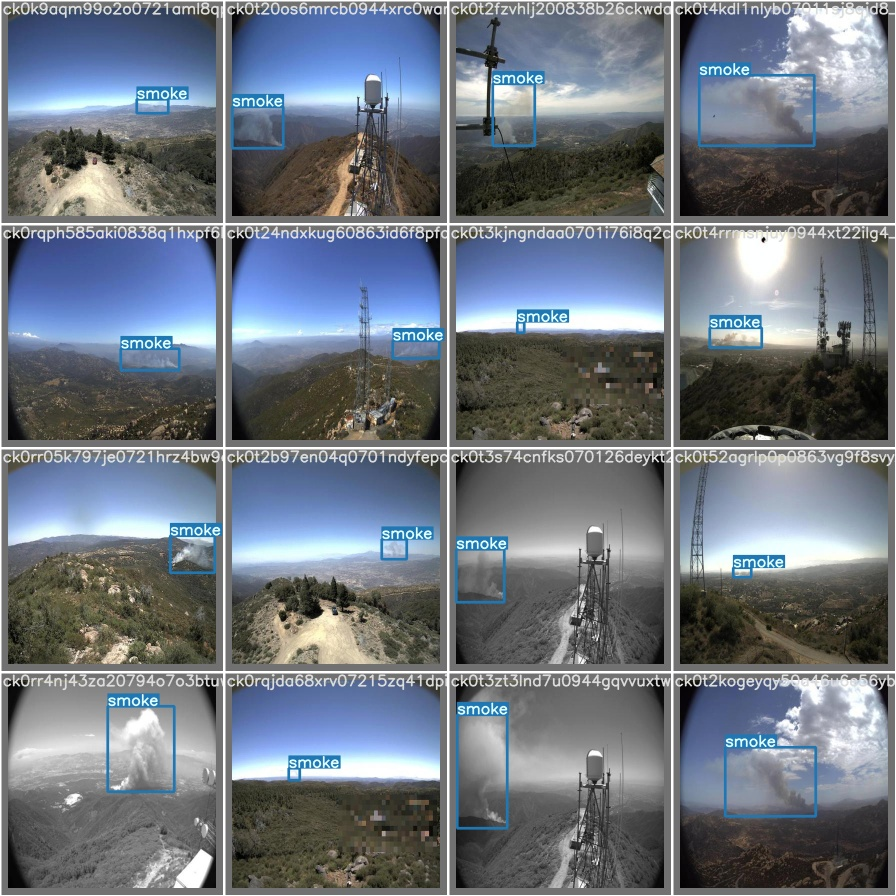

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TESTING DATA:")
Image(filename='/content/ScaledYOLOv4/test_batch0_gt.jpg', width=900)

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/ScaledYOLOv4/runs/exp2_yolov4-p5-results/train_batch0.jpg', width=900)

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

exp0_yolov4-p6-results/


In [ ]:
%ls runs/exp0_yolov4-p6-results/weights

best_yolov4-p6-results.pt        last_330.pt  last_342.pt
best_yolov4-p6-results_strip.pt  last_331.pt  last_343.pt
last_320.pt                      last_332.pt  last_344.pt
last_321.pt                      last_333.pt  last_345.pt
last_322.pt                      last_334.pt  last_346.pt
last_323.pt                      last_335.pt  last_347.pt
last_324.pt                      last_336.pt  last_348.pt
last_325.pt                      last_337.pt  last_349.pt
last_326.pt                      last_338.pt  last_yolov4-p6-results.pt
last_327.pt                      last_339.pt  last_yolov4-p6-results_strip.pt
last_328.pt                      last_340.pt
last_329.pt                      last_341.pt


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cp /content/drive/My\ Drive/Dsbda_mini_project/best.pt /content/ScaledYOLOv4/weights

In [ ]:
%cd /content/ScaledYOLOv4/
!python test.py --img 416 --conf 0.001 --batch 16 --device 0 --data '../data.yaml' --weights weights

/content/ScaledYOLOv4
Namespace(augment=False, batch_size=16, conf_thres=0.001, data='../data.yaml', device='0', img_size=416, iou_thres=0.65, merge=False, save_json=False, save_txt=False, single_cls=False, task='val', verbose=False, weights=['weights'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

Fusing layers... Model Summary: 331 layers, 7.0227e+07 parameters, 6.81919e+07 gradients
Scanning labels ../valid/labels.cache (147 found, 0 missing, 0 empty, 0 duplicate, for 147 images): 100% 147/147 [00:00<00:00, 14406.68it/s]
               Class      Images     Targets           P           R      mAP@.5  mAP@.5:.95: 100% 10/10 [00:02<00:00,  4.02it/s]
                 all         147         147       0.565       0.966       0.951       0.454
Speed: 11.0/0.6/11.6 ms inference/NMS/total per 416x416 image at batch-size 16


In [ ]:
# using the best weights
%cd /content/ScaledYOLOv4/
#!python detect.py --weights runs/exp0_yolov4-p6-results/weights/best_yolov4-p6-results.pt --img 5024 --conf 0.4 --source ../test/images
!python detect.py --weights weights --img 416 --conf 0.4 --source ../test/images

/content/ScaledYOLOv4
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/images', update=False, view_img=False, weights=['weights'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

Fusing layers... Model Summary: 331 layers, 7.0227e+07 parameters, 6.81919e+07 gradients
image 1/74 /content/test/images/ck0k9ghqt7a8l0944mcvy0jsx_jpeg.rf.67e2a90371e4338bd4f02e3d788e5399.jpg: 416x416 1 smokes, Done. (0.031s)
image 2/74 /content/test/images/ck0kcju199xgd0721ljl6cd2n_jpeg.rf.20be4ec6529ae16ff082da6d800580c9.jpg: 416x416 1 smokes, Done. (0.029s)
image 3/74 /content/test/images/ck0kcko719xjn0721pujcl4if_jpeg.rf.0358b337ab700afd5371bf4b6aecb909.jpg: 416x416 1 smokes, Done. (0.028s)
image 4/74 /content/test/images/ck0kd70pu4w7b07946742zfpg_jpeg.rf.fd8cfe9bbc0890c948142898867447e8.jpg: 416x416 1 smokes, Done. (0.028s)
image 5/74 /co

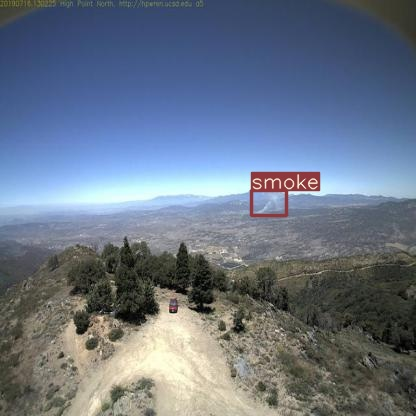

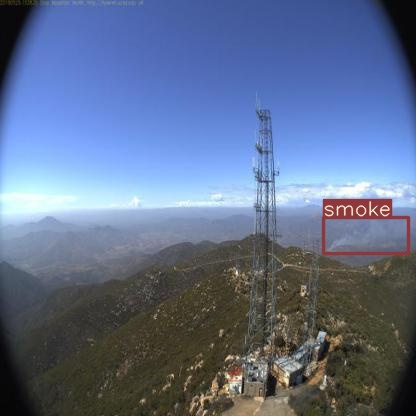

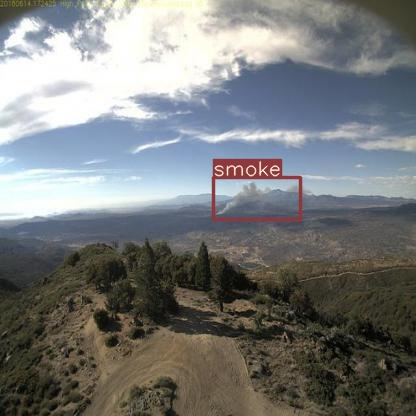

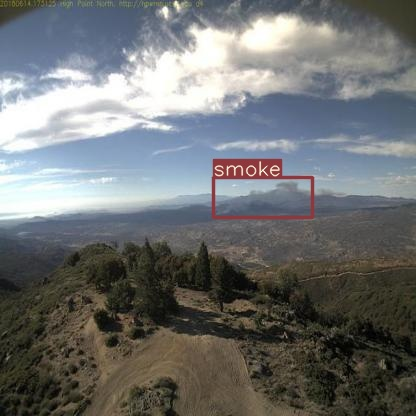

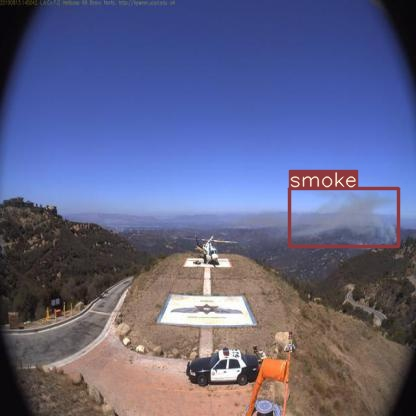

...

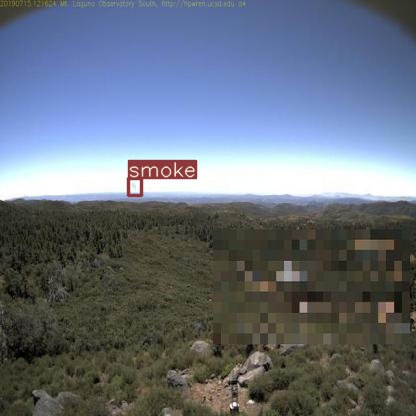

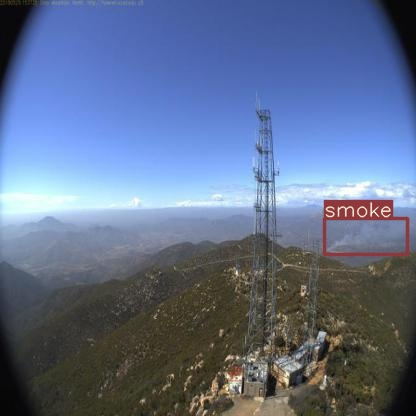

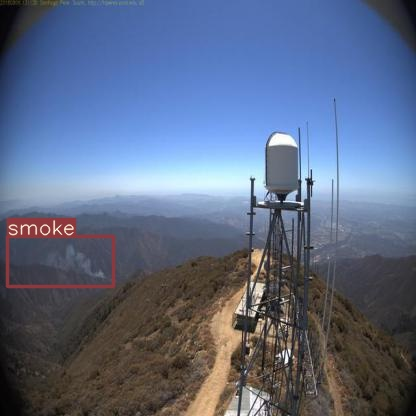

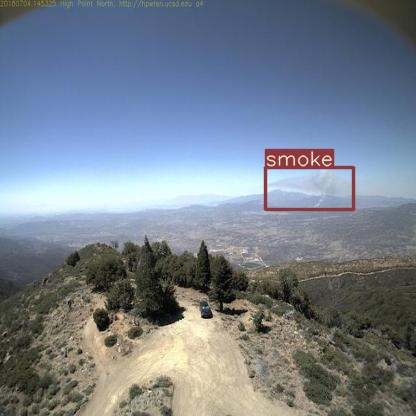

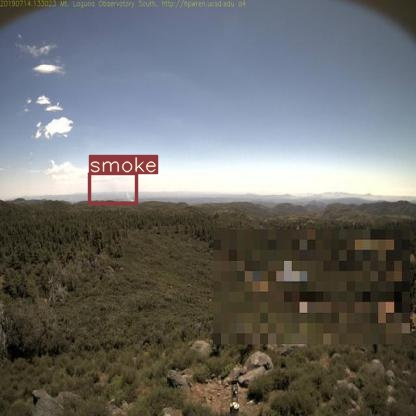

In [ ]:
#displaying inference on test image(s)
import glob
from IPython.display import Image, display

for imageName in glob.glob('./inference/output/*.jpg'):
    display(Image(filename=imageName))
    print("\n")

In [ ]:
from google.colab import files
files.download('./runs/exp3_yolov4-p6-results/weights/best.pt')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cp /content/ScaledYOLOv4/runs/exp2_yolov4-p5-results/weights/best.pt /content/drive/My\ Drive/Dsbda_mini_project